# Import Libraries

This part of code will import all the necessary libraries required for the code

In [1]:
from pyDTDM import *
import warnings
import yaml
try:
    from yaml import Cloader as Loader
except ImportError:

    from yaml import Loader

from adjustText import adjust_text
from shapely.geometry import LineString
from joblib import Parallel, delayed
import pandas as pd

from scipy.stats import gaussian_kde
import matplotlib.cm as cm
import cmcrameri.cm as cmc
import matplotlib.patches as mpatches
import os, sys
import cartopy.crs as ccrs
import warnings

import pygmt
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import xarray as xr

/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/ptt/documentation.py:3: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.


# Load Input File

The input file can be changed to include other parameters as well

In [2]:
config_file="InputFiles/InputFiles.yaml"
with open(config_file) as f:
    PARAMS = yaml.load(f, Loader=Loader)
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(" Parameters set from %s" % config_file)
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")


––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
 Parameters set from InputFiles/InputFiles.yaml
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 


### Reading the input file

In [3]:
# Input Files 
MODEL_NAME=PARAMS['InputFiles']['plate_kinematics']['model_name'] # model name
MODEL_DIR = PARAMS['InputFiles']['plate_kinematics']['model_dir']  ## plate model location
topology_filenames =[f"{MODEL_DIR}/{i}" for i in PARAMS['InputFiles']['plate_kinematics']['topology_files']]
rotation_filenames = [f"{MODEL_DIR}/{i}" for i in PARAMS['InputFiles']['plate_kinematics']['rotation_files']]
agegrid=PARAMS['InputFiles']['plate_kinematics']['agegrid'] ## agegrid location

ETOPO_FILE=PARAMS['InputFiles']['Raster']['ETOPO_FILE'] # ETOPO grid in meters (can be netCDf or GeoTiff)
ETOPO_Type=PARAMS['InputFiles']['Raster']['Raster_type']
coastlines = f"{MODEL_DIR }/{PARAMS['InputFiles']['plate_kinematics']['coastline_file']}"
static_polygon_file=f"{MODEL_DIR }/{PARAMS['InputFiles']['plate_kinematics']['static_polygon']}"
static_polygons = pygplates.FeatureCollection(static_polygon_file)
continents=f"{MODEL_DIR }/{PARAMS['InputFiles']['plate_kinematics']['continents']}"
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print("Reading input file..... \n")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(f"Plate Model: {MODEL_NAME} \n")
print(f"Model Directory: {MODEL_DIR} \n")
print(f"Coastlines: {coastlines} \n")
print(f"Continents: {continents} \n")
print(f"Static Polygons: {static_polygon_file} \n")
print(f"Model Agegrid: {agegrid} \n")
print(f"ETopo grid: {ETOPO_FILE}")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– \n")

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Reading input file..... 

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Plate Model: Zahirovic_etal_2022_GDJ_NNR 

Model Directory: ../../../PlateReconstruction 

Coastlines: ../../../PlateReconstruction/StaticGeometries/Coastlines/Global_coastlines_low_res.shp 

Continents: ../../../PlateReconstruction/StaticGeometries/ContinentalPolygons/Global_EarthByte_GPlates_PresentDay_ContinentalPolygons.shp 

Static Polygons: ../../../PlateReconstruction/StaticGeometries/StaticPolygons/Global_EarthByte_GPlates_PresentDay_StaticPlatePolygons.shp 

Model Agegrid: ../../../PlateReconstruction/SeafloorAgegrid 

ETopo grid: ../../../ETOPO/Smoothed Etopo.tif
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 



### Setting model parameters

In [4]:
Paleomag_ID=PARAMS['Parameters']['paleomag_id']
Mantle_ID=PARAMS['Parameters']['mantle_optimised_id']

#The initial positions of crustal points are evenly distributed within the designated region. 
# At mesh refinement level zero, the points are approximately 20 degrees apart.
# Each increase in the density level results in a halving of the spacing between points.
MESH_REFINEMENT_LEVEL=PARAMS['Parameters']['mesh_refinement_level']  # higher refinement level will take longer time to run for optimisation 
WINDOW_SIZE=int(PARAMS['Parameters']['time_window_size'])
Weighted=PARAMS['Parameters']['weighted_mean']


NETCDF_GRID_RESOLUTION=PARAMS['GridParameters']['grid_spacing']  # in degree
ZLIB=PARAMS['GridParameters']['compression']['zlib'] 
COMPLEVEL=PARAMS['GridParameters']['compression']['complevel'] 

FROM_TIME=int(PARAMS['TimeParameters']['time_max'])
TO_TIME=int(PARAMS['TimeParameters']['time_min'])
TIME_STEPS=int(PARAMS['TimeParameters']['time_step'])




parallel=PARAMS['Parameters']['number_of_cpus']### No of core to use or None for single core


print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print("The following parameters are set-")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(f"NNR Mantle Reference Frame ID: {Mantle_ID}")
print(f"Paleomagnetic Reference Frame ID: {Paleomag_ID} \n")

print(f"Moving Window Size: {WINDOW_SIZE}")
print(f"Weighted Mean: {Weighted}")

print(f"Mesh Refinement Level: {MESH_REFINEMENT_LEVEL}")
print(f"NetCDF GRID Resolution: {NETCDF_GRID_RESOLUTION}")
print(f"NetCDF Compression Level: {COMPLEVEL} \n")
print(f"Model Start Time: {FROM_TIME}")
print(f"Model End Time: {TO_TIME}")
print(f"Model Time Step: {TIME_STEPS}\n")


print(f"Number of CPU: {parallel}") # -1 means all the freely available CPU


print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
The following parameters are set-
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
NNR Mantle Reference Frame ID: 666666
Paleomagnetic Reference Frame ID: 0 

Moving Window Size: 15
Weighted Mean: True
Mesh Refinement Level: 9
NetCDF GRID Resolution: 0.1
NetCDF Compression Level: 5 

Model Start Time: 125
Model End Time: 0
Model Time Step: 1

Number of CPU: -1
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 


### Creating Output File

The output will be stored in the output folder: Paleotopography

There will be two folder:
- CSV Folder: to store data in tabular format. Here I have used paraquet file because it reduces the storage 
- NetCDF Folder: to store final NetCDF that can be visualised in GPlates


In [5]:
# Output Directory
OUTPUT_FOLDER=PARAMS['OutputFiles']['output_dir']

DEFAULT_OUTPUT_CSV=os.path.join(OUTPUT_FOLDER,'CSV')  # folder to store output in Tabular format
DEFAULT_OUTPUT_NetCDF=os.path.join(OUTPUT_FOLDER,'NetCDF') # folder to store output NetCDF grid
DEFAULT_OUTPUT_Figure=os.path.join(OUTPUT_FOLDER,'Figure')




print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(f"All the output will be saved in {OUTPUT_FOLDER}")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
create_directory_if_not_exists(OUTPUT_FOLDER)
create_directory_if_not_exists(DEFAULT_OUTPUT_CSV)
create_directory_if_not_exists(DEFAULT_OUTPUT_NetCDF)
create_directory_if_not_exists(DEFAULT_OUTPUT_Figure)
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")


––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
All the output will be saved in ../../../EBM_Results
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Created directory: ../../../EBM_Results/NetCDF
––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 


# Define Plate Reconstruction

class PlateKinematicsParameters can be used to define plate kinematics parameters. To know more about class you can use `help` functions. For e.g. help(PlateKinematicsParameters) 

In [6]:

PK=PlateKinematicsParameters(topology_filenames, 
                             rotation_filenames,
                             static_polygons,
                             agegrid=agegrid,
                             coastlines=coastlines,
                             continents=continents,
                             anchor_plate_id=Mantle_ID)

time = 0 #Ma
gplot = gplately.PlotTopologies(PK.model, coastlines=coastlines, continents=continents, time=time) ##gplately plotting object


In [7]:
all_sz_df=pd.read_parquet(f"{DEFAULT_OUTPUT_CSV}/ALL_Subduction.paraquet") 

## Adding a Climate Model

**Note:** The Li paleoclimate model uses the Scotese Paleomap reconstruction.  
Therefore, its reference frame differs from that of Zahirovic et al. (2022). So we will need to use different reconstruction


In [8]:

CLIMATEMODEL_DIR=PARAMS['InputFiles']['precipitation']['model_dir']
CLIMATEMODEL_NAME=PARAMS['InputFiles']['precipitation']['model_name']

scotese_static_poly=f"{CLIMATEMODEL_DIR}/{PARAMS['InputFiles']['precipitation']['topology_files'][0]}"
scotese_rotation=f"{CLIMATEMODEL_DIR}/{PARAMS['InputFiles']['precipitation']['rotation_files'][0]}"

# Print inputs in a clear, copyable block
print("\n=== Input files for paleoclimate ===")
print(f"Climate model directory:  {CLIMATEMODEL_DIR}")
print(f"Climate model name:       {CLIMATEMODEL_NAME}")
print(f"PALEOMAP static polygons: {scotese_static_poly}  # .gpml")
print(f"PALEOMAP rotations:       {scotese_rotation}     # .rot")
print("=================================\n")

CM=ClimateParameters(topology_filenames, 
                             rotation_filenames,
                             static_polygons,
                             agegrid=agegrid,
                             coastlines=coastlines,
                             continents=continents,
                             anchor_plate_id=Paleomag_ID)



=== Input files for paleoclimate ===
Climate model directory:  ../../../PaleoClimateSimulations/ScotesePlateReconstruction
Climate model name:       PALEOMAP
PALEOMAP static polygons: ../../../PaleoClimateSimulations/ScotesePlateReconstruction/PALEOMAP_PlatePolygons.gpml  # .gpml
PALEOMAP rotations:       ../../../PaleoClimateSimulations/ScotesePlateReconstruction/PALEOMAP_PlateModel.rot     # .rot



# Local Functions

In [9]:
def plotgdf(gdf,gplot,column=None,mollweide=False,time=0,cbar=False,quick=True,**kwargs):

    '''This function can be used to plot the reconstructed geodataframe at any time along with topologies and 
    features. If the data is large it will take a lot of time to plot. Turn quick to True to plot the data faster.
    However, there may be some issues with the colors.

    gdf: gpd.GeoDataFrame
    model: gplatey.PlateReconconstruction
    column: name of the colum to be plotted (str)
    time: reconstruction time (int)
    cbar: whether to display colorbar

    '''
    
    cmap = kwargs.get('cmap', None)
    vmin = kwargs.get('vmin', None)
    vmax = kwargs.get('vmax', None)
    label = kwargs.get('label', None)
    title=kwargs.get('title', None)
    features=kwargs.get('features',True)
    color=kwargs.get('color',None)
    markersize=kwargs.get('markersize',10)
    orientation=kwargs.get('orientation','vertical')
    shrink=kwargs.get('shrink',0.5)
    extend=kwargs.get('extend',None)
    
    central_longitude=kwargs.get('central_longitude',0)
    figsize=kwargs.get('figsize',(12,8))
    
    
    
    
    
    
    fig = plt.figure(figsize=figsize, dpi=300)
    # gplot = gplately.PlotTopologies(model, coastlines=model.coastlines, continents=model.continents, time=time)

    if mollweide:
        ax = fig.add_subplot(111, projection=ccrs.Mollweide(central_longitude = central_longitude))
        ax.gridlines(color='0.7',linestyle='--', xlocs=np.arange(-180,180,30), ylocs=np.arange(-90,90,30))
    
        mollweide_proj = f"+proj=moll +lon_0={central_longitude} +x_0=0 +y_0=0 +datum=WGS84 +units=m +no_defs"
        gdf=gdf.to_crs(mollweide_proj)
    else:
        ax = fig.add_subplot(111, projection=ccrs.PlateCarree(central_longitude = central_longitude))
        ax.gridlines(color='0.7',linestyle='--', xlocs=np.arange(-180,180,15), ylocs=np.arange(-90,90,15))
    
        
        
    if features:
    
        # Plot shapefile features, subduction zones and MOR boundaries at time Ma
        gplot.time = time # Ma
        gplot.plot_continents(ax, facecolor='grey', alpha=0.2)
        gplot.plot_coastlines(ax, color='skyblue',alpha=0.3)
        gplot.plot_ridges_and_transforms(ax, color='k')
        gplot.plot_trenches(ax, color='k')
        gplot.plot_subduction_teeth(ax, color='k')

        gplot.plot_ridges(ax, color='k')
        gplot.plot_transforms(ax, color='k')
        gplot.plot_misc_boundaries(ax, color='k')

    
        # Plot the GeoDataFrame
    
    if quick:
        da=df_to_NetCDF(x=gdf["Longitude"],y=gdf["Latitude"],z=gdf[column],grid_resolution=0.2)
        plot=gplot.plot_grid(ax=ax, grid=da,**{'cmap':cmap,'vmax':vmax,'vmin': vmin})
    else:
        plot = gdf.plot(ax=ax, cmap=cmap, column=column,vmax=vmax,vmin=vmin,color=color,markersize=markersize)
    

                                             # 'label':f'{column}'})
    if cbar:
        # Create a ScalarMappable object
        sm = cm.ScalarMappable(cmap=cmap)
        sm.set_array(gdf[column])
        sm.set_clim(vmin, vmax)
        
        # Add colorbar using the same Axes object used for plotting
        colorbar = plt.colorbar(sm, ax=ax, orientation=orientation,shrink=shrink,extend=extend, label=label)
        colorbar.set_label(label)
    
    ax.set_global()
    
    return ax    

In [10]:
def mean_subduction_params(
    training_data_folder, 
    starttime, 
    endtime, 
    mean_columns=None,       # columns to perform cumulative averaging
    humid_belt=False, 
    lat_band=10
):
    """
    Compute cumulative (or mean) subduction parameters over a time range.

    Parameters
    ----------
    training_data_folder : str
        Folder containing per-time parquet files named `Training_Data_<t>.csv`.
    starttime : int
        Start time (inclusive).
    endtime : int
        End time (exclusive).
    mean_columns : list of str
        Columns to perform cumulative mean on. If None, all numeric columns (except ignored ones) are used.
    humid_belt : bool
        Whether to add a 'Humid Belt' column based on latitude.
    lat_band : int
        Latitude band size for humid belt assignment.

    Returns
    -------
    cumulative : pandas.DataFrame
        Cumulative DataFrame over the time range.
    """
    
    times = np.arange(starttime, endtime)
    
    # Load the first timestep
    df = pd.read_parquet(f"{training_data_folder}/Training_Data_{times[0]}.csv")
    
    # Automatically determine columns to process if not provided
    ignore_cols = ['Latitude', 'Longitude', 'geometry', 'Trench Distance', 'Elevation(Scotese)']
    if mean_columns is None:
        mean_columns = [col for col in df.columns if col not in ignore_cols]
    
    # Initialize cumulative DataFrame
    cumulative = df.copy()
    cumulative[mean_columns] = cumulative[mean_columns] / (endtime - starttime)
    
    # Optionally, add Humid Belt column
    if humid_belt:
        cumulative['Humid Belt'] = df['Latitude'].apply(lambda x: assign_belt(x, lat_band))
    
    # Loop over remaining times
    for t in times[1:]:
        df = pd.read_parquet(f"{training_data_folder}/Training_Data_{t}.csv")
        
        # Update cumulative columns
        cumulative[mean_columns] += df[mean_columns] / (endtime - starttime)
        
        if humid_belt:
            cumulative['Humid Belt'] += df['Latitude'].apply(lambda x: assign_belt(x, lat_band))
    
    return cumulative



# Getting Mean Parameters

In [11]:
processed_training_data=f"{DEFAULT_OUTPUT_CSV}/Training_Data_Processed"
### Loading the data
mean_params=mean_subduction_params(training_data_folder=processed_training_data,
                                        starttime=TO_TIME,endtime=WINDOW_SIZE)


## Filtering data within active margins

In [12]:
gdf_points=gpd.GeoDataFrame(mean_params,geometry=latlonlist2point(mean_params['Latitude'],mean_params['Longitude']))
gdf_points=gdf_points.set_crs(DEFAULT_CRS)

In [13]:
filtered_df2=gpd.read_file(f"{DEFAULT_OUTPUT_CSV}/Filtered_GMBA_Hier_Lvl4.shp")

In [14]:

# Explode multipolygon geometries into individual polygons
filtered_df2_exploded = filtered_df2.explode(index_parts=False)

# Ensure both GeoDataFrames have the same CRS
gdf_points = gdf_points.to_crs(DEFAULT_CRS)
filtered_df2_exploded = filtered_df2_exploded.to_crs(DEFAULT_CRS)

# Perform the spatial join using the 'intersects' predicate
filtered_data = gpd.sjoin(gdf_points, filtered_df2_exploded, how='left', predicate='intersects')

# Filter out points that do not intersect with any polygon
filtered_data = filtered_data.dropna(subset=['index_right'])

# Get the filtered gdf_points with overlapping geometries
filtered_gdf_points = gdf_points[gdf_points.index.isin(filtered_data.index)]

# Visualize the result
# print(filtered_gdf_points)


/var/folders/qr/01bxwnvn05s319mx5c07sd7w0000gp/T/ipykernel_10807/2205206840.py:56: DeprecationWarning: Deprecated! The 'plot_ridges_and_transforms' function will be removed in the future GPlately releases. Update your workflow to use the 'plot_ridges' and 'plot_transforms' functions instead, otherwise your workflow will not work with the future GPlately releases.


<GeoAxes: >

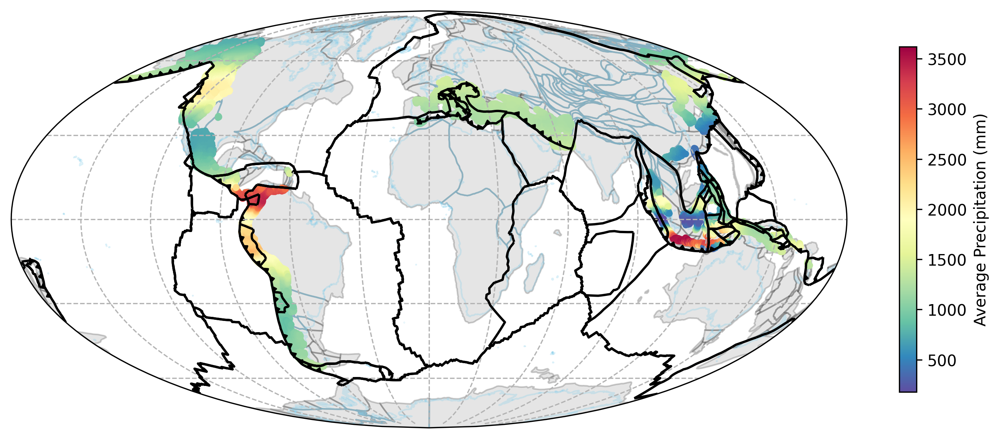

In [15]:
gdf_points=filtered_gdf_points.set_crs("EPSG:4326")
kwaargs={'cmap':'Spectral_r','label':f'Average Precipitation (mm)','figsize':(12,8)}
# plotgdf(gdf_points,mollweide=True,column="Subduction Volume Rate")
plotgdf(gdf_points, model=PK.model,mollweide=True,column="Precipitation",gplot=gplot,quick=False,cbar=True,**kwaargs)
# plotg

# Define Mantle Convection Parameters

This section of code will read all the input parameters for mantle convection model

In [16]:
# Input Files 
MANTLE_MODEL_NAME=PARAMS['InputFiles']['mantle_convection']['model_name']
MANTLE_MODEL_DIR = PARAMS['InputFiles']['mantle_convection']['model_dir']  ## plate model
MANTLE_topology_filenames =[f"{MODEL_DIR}/{i}" for i in PARAMS['InputFiles']['mantle_convection']['topology_files']]
MANTLE_rotation_filenames = [f"{MODEL_DIR}/{i}" for i in PARAMS['InputFiles']['mantle_convection']['rotation_files']]

MANTLE_depths= PARAMS['InputFiles']['mantle_convection']['depth']
MANTLE_vel_folder=PARAMS['InputFiles']['mantle_convection']['new_vel_folder']
MANTLE_temp_folder=PARAMS['InputFiles']['mantle_convection']['new_temp_folder']

MANTLE_org_vel=PARAMS['InputFiles']['mantle_convection']['original_vel_folder']
MANTLE_org_temp=PARAMS['InputFiles']['mantle_convection']['original_temp_folder']


MANTLE_velx_folder=PARAMS['InputFiles']['mantle_convection']['new_velx_folder']
MANTLE_org_velx=PARAMS['InputFiles']['mantle_convection']['original_velx_folder']

MANTLE_vely_folder=PARAMS['InputFiles']['mantle_convection']['new_vely_folder']
MANTLE_org_vely=PARAMS['InputFiles']['mantle_convection']['original_vely_folder']

MANTLE_visc_folder=PARAMS['InputFiles']['mantle_convection']['new_visc_folder']
MANTLE_org_visc=PARAMS['InputFiles']['mantle_convection']['original_visc_folder']

MANTLE_td_folder=PARAMS['InputFiles']['mantle_convection']['new_temp_dev_folder']
MANTLE_org_td=PARAMS['InputFiles']['mantle_convection']['original_temp_dev_folder']


print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print("Reading input file..... \n")
print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– ")
print(f"Mantle Convection Plate Model: {MANTLE_MODEL_NAME} \n")
print(f"Mantle Convection Plate Model Directory: {MANTLE_MODEL_DIR} \n")

print(f"Mantle Convection Velocity: {MANTLE_vel_folder} \n")
print(f"Mantle Convection Temperature: {MANTLE_temp_folder} \n")

print(f"Mantle Convection Velocity: {MANTLE_org_vel} \n")
print(f"Mantle Convection Temperature: {MANTLE_org_temp} \n")

print(f"Mantle Convection Depths: {MANTLE_depths} \n")

print("––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– \n")

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Reading input file..... 

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 
Mantle Convection Plate Model: Zahirovic_etal_2022_GDJ_NNR 

Mantle Convection Plate Model Directory: ../../../PlateReconstruction 

Mantle Convection Velocity: ../../../EBM_Results/vz_dimensional 

Mantle Convection Temperature: ../../../EBM_Results/temp_dimensional 

Mantle Convection Velocity: ../../../CITCOMSGeodynamics/vz_dimensional 

Mantle Convection Temperature: ../../../CITCOMSGeodynamics/temp_dimensional 

Mantle Convection Depths: [16, 31, 47, 62, 140, 155, 171, 186, 202, 217, 233, 268, 293, 323, 357, 396, 439, 487, 540, 597, 660, 726, 798, 874, 954, 1040] 

––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––– 



In [17]:
MT=MantleParameters(original_folder=MANTLE_org_temp,
                    new_folder=MANTLE_temp_folder,
                    parameter_type="Mantle_Temp", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)
VZ=MantleParameters(original_folder=MANTLE_org_vel,
                    new_folder=MANTLE_vel_folder,
                    parameter_type="Mantle_Velocity", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)
VX=MantleParameters(original_folder=MANTLE_org_velx,
                    new_folder=MANTLE_velx_folder,
                    parameter_type="Mantle_Velocity_X", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)

VY=MantleParameters(original_folder=MANTLE_org_vely,
                    new_folder=MANTLE_vely_folder,
                    parameter_type="Mantle_Velocity_Y", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)

VISC=MantleParameters(original_folder=MANTLE_org_visc,
                    new_folder=MANTLE_visc_folder,
                    parameter_type="Viscocity", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)
TD=MantleParameters(original_folder=MANTLE_org_td,
                    new_folder=MANTLE_td_folder,
                    parameter_type="Temp_Dev", 
                    depths=MANTLE_depths, 
                    starttime=TO_TIME,
                    endtime=FROM_TIME,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)

Created directory: ../../../EBM_Results/temp_dimensional
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Created directory: ../../../EBM_Results/vz_dimensional
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Created directory: ../../../EBM_Results/vx_dimensional
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Created directory: ../../../EBM_Results/vy_dimensional
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Created directory: ../../../EBM_Results/visc
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Created directory: ../../../EBM_Results/temp_deviation
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'


### Interpolate Mantle Convection Data at Each Timestep

If mantle parameters are not available at uniform timesteps, you can use **linear interpolation** to generate values at the desired times.

> **Note:** This interpolation will produce a large amount of data. Interpolated data is **not required for training** and is mainly useful for predicting topography in deep time.

However, you may still need to run this step to **copy data in working directory and correct the CRS**.

If your goal is only **EBM analysis**, you do **not** need to run the interpolation for the entire time range (`FROM_TIME` to `TO_TIME`). Instead, select a **smaller time window** to save computation and storage.

To enable this functionality, uncomment the **MT** and **Vz** class definitions below.


In [34]:

MT=MantleParameters(original_folder=MANTLE_org_temp,
                    new_folder=MANTLE_temp_folder,
                    parameter_type="Mantle_Temp", 
                    depths=MANTLE_depths, 
                    starttime=0,
                    endtime=10,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)
VZ=MantleParameters(original_folder=MANTLE_org_vel,
                    new_folder=MANTLE_vel_folder,
                    parameter_type="Mantle_Velocity", 
                    depths=MANTLE_depths, 
                    starttime=0,
                    endtime=10,
                    timestep=TIME_STEPS, 
                    anchor_plate_id=Mantle_ID)

MT.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
VZ.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
# VX.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
# VY.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
# VISC.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)
# TD.interpolate_mantle_data(n_jobs=parallel,required_timesteps=TIME_STEPS)

Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'
Rotation File not provided!
Topologies not provided
'MantleParameters' object has no attribute 'rotation_model'


/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/ptt/documentation.py:3: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/ptt/documentation.py:3: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/ptt/documentation.py:3: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to S

Created directory: ../../../EBM_Results/temp_dimensional/0
Created directory: ../../../EBM_Results/temp_dimensional/0
Created directory: ../../../EBM_Results/temp_dimensional/6
Created directory: ../../../EBM_Results/temp_dimensional/10
Created directory: ../../../EBM_Results/temp_dimensional/1
Created directory: ../../../EBM_Results/temp_dimensional/2
Created directory: ../../../EBM_Results/temp_dimensional/3
Created directory: ../../../EBM_Results/temp_dimensional/4
Created directory: ../../../EBM_Results/temp_dimensional/5
Interpolation completed from 0 Ma to 6 Ma completed.
Created directory: ../../../EBM_Results/temp_dimensional/7
Created directory: ../../../EBM_Results/temp_dimensional/8
Created directory: ../../../EBM_Results/temp_dimensional/9
Interpolation completed from 6 Ma to 10 Ma completed.
Created directory: ../../../EBM_Results/vz_dimensional/0
Created directory: ../../../EBM_Results/vz_dimensional/6
Created directory: ../../../EBM_Results/vz_dimensional/10
Created dire

# Extract Mantle Convection Grid


In [35]:
mean_params=filtered_gdf_points.drop(columns=['geometry'])

In [36]:
reconstruction_time=0
TrainingData=MT.get_mantle_parameters(mean_params,reconstruction_time, depth_wise=True,n_jobs=parallel) ## getting mantle temp
TrainingData=VZ.get_mantle_parameters(TrainingData,reconstruction_time, depth_wise=True,n_jobs=parallel) ## getting vertical mantle vel


/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/joblib/externals/loky/process_executor.py:782: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.


In [ ]:
## checking if the data is fetched correctly from file.
TrainingData['Mantle_Velocity_202']

0        -0.223331
1        -0.223331
2        -0.223331
3        -0.223331
4        -0.419469
            ...   
145491    0.841013
145492    0.680021
145493    0.621790
145494    0.621790
145495    0.621790
Name: Mantle_Velocity_202, Length: 111124, dtype: float32

### Calculating mean of upper mantle

In [38]:
features=TrainingData.copy()
col2rm=[]
depths=[]
for depth in MANTLE_depths:
    col2rm.append(f'Mantle_Temp_{depth}')
    col2rm.append(f'Mantle_Velocity_{depth}')
    
    if (depth>200 and depth<=440):
        if depth==202:
            features['Mantle Temperature']=features[f'Mantle_Temp_{depth}']
            features['Mantle Velocity']=features[f'Mantle_Velocity_{depth}'] 
        else:  
            features['Mantle Temperature']=features['Mantle Temperature']+features[f'Mantle_Temp_{depth}']
            features['Mantle Velocity']=features['Mantle Velocity']+features[f'Mantle_Velocity_{depth}']
        depths.append(depth)
    else:
        continue

    
features['Mantle Temperature']=features['Mantle Temperature']/len(depths)
features['Mantle Velocity']=features['Mantle Velocity']/len(depths)

In [39]:
features = features.drop(col2rm, axis=1)
features["Migration Rate"]=features["Migration Rate"]*1e2 # in cm/yr 
features["Trench Distance"]=features["Trench Distance"]/1e3 # in km 

## Sample Elevation as Training Data points

In [40]:

columns_data=['Migration Rate','Subduction Volume Rate','Trench Distance','Precipitation', 'Mantle Temperature',
       'Mantle Velocity','Elevation']
ETopo=BhuRaster(folder_location=ETOPO_FILE,Raster_Type=ETOPO_Type)
features=ETopo.get_parameters(features)
features=features[columns_data]

# Plotting Training Features

In [41]:
featuresc=pd.DataFrame()
featuresc['Elevation (m)']= features['Elevation']
featuresc['Subduction Flux (km$^3$/yr)']=features['Subduction Volume Rate']
featuresc['Trench Migration Rate (cm/yr)']=features['Migration Rate']
featuresc['Trench Distance (km)']=features['Trench Distance']
featuresc['Mantle Temperature ($^o$C)']=features['Mantle Temperature']
featuresc['Mantle Velocity (cm/yr)']=features['Mantle Velocity']
featuresc['Mean Precipitation (mm)']=features['Precipitation']

In [42]:
gdf_points=gpd.GeoDataFrame(featuresc,geometry=gpd.points_from_xy(TrainingData['Longitude'],TrainingData['Latitude']))
gdf_points=gdf_points.set_crs(DEFAULT_CRS)

In [43]:
gdf_points['Longitude']=TrainingData['Longitude']
gdf_points['Latitude']=TrainingData['Latitude']

In [44]:
gdf_points

,Elevation (m),Subduction Flux (km$^3$/yr),Trench Migration Rate (cm/yr),Trench Distance (km),Mantle Temperature ($^o$C),Mantle Velocity (cm/yr),Mean Precipitation (mm),geometry,Longitude,Latitude
0,829.716492,0.027602,2.049141,659.419160,1259.969360,-0.494672,1248.869719,POINT (61.1509 32.5124),61.1509,32.5124
1,825.992310,0.027571,2.049573,669.036626,1259.969360,-0.494672,1243.476793,POINT (61.1509 32.6124),61.1509,32.6124
2,960.218201,0.027928,1.998728,664.131557,1259.969360,-0.494672,1248.827427,POINT (61.2509 32.5124),61.2509,32.5124
3,910.482483,0.027704,2.023247,673.756418,1259.969360,-0.494672,1243.470421,POINT (61.2509 32.6124),61.2509,32.6124
4,676.501099,0.028476,1.925657,639.245243,1219.933960,-0.649845,1251.189189,POINT (61.3509 32.2124),61.3509,32.2124
...,...,...,...,...,...,...,...,...,...,...
145491,38.126770,0.025780,-4.259435,467.957548,1202.191895,0.196916,1413.841145,POINT (152.7506 -10.6606),152.7506,-10.6606
145492,131.765366,0.023344,-4.754705,479.053212,1196.007202,0.277144,1412.124224,POINT (153.4506 -11.4606),153.4506,-11.4606
145493,59.374172,0.027501,-4.241392,425.558386,1193.675659,-0.055060,1447.481094,POINT (154.0506 -11.3606),154.0506,-11.3606
145494,121.880447,0.029823,-4.269139,418.299324,1193.675659,-0.055060,1451.787275,POINT (154.1506 -11.3606),154.1506,-11.3606


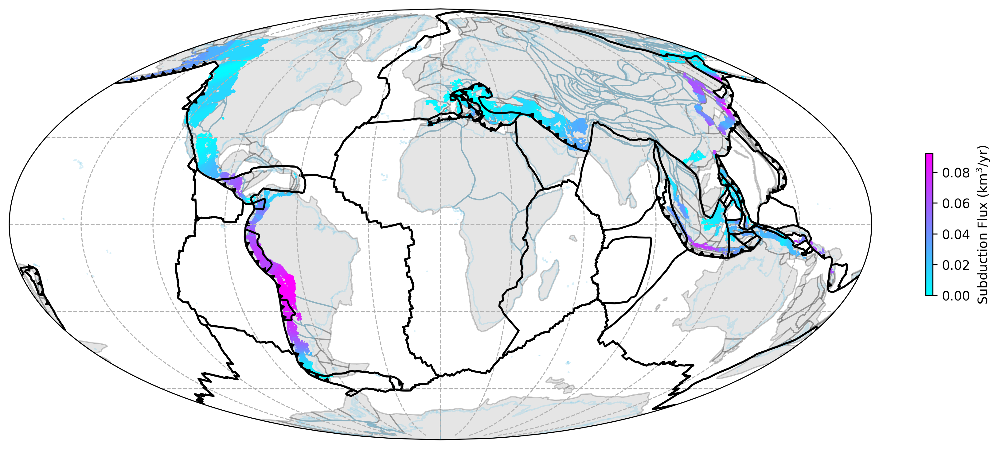

In [184]:
column="Subduction Flux (km$^3$/yr)"
kwaargs={'cmap':'cool','label':f'{column}','figsize':(12,8),'shrink':0.2,'markersize':0.1}
plotgdf(gdf_points,gplot=gplot,mollweide=True,column=column,cbar=True,quick=False,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Subduction Flux Rate.png")
plt.show()

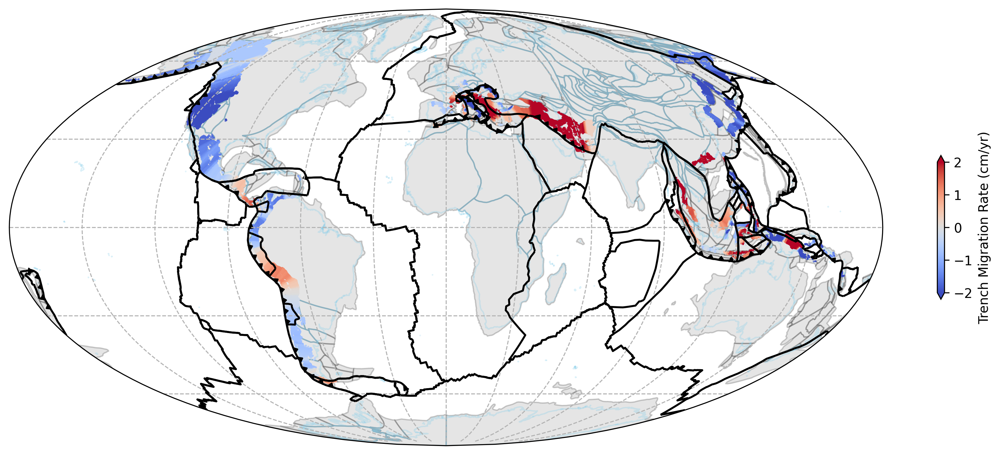

In [185]:
column='Trench Migration Rate (cm/yr)'
kwaargs={'cmap':'coolwarm','label':f'{column}','figsize':(12,8),'shrink':0.2,'vmin':-2,'vmax':2,'extend':'both','markersize':0.1}
plotgdf(gdf_points,model=PK.model,quick=False,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Trench Migration Rate.png")
plt.show()

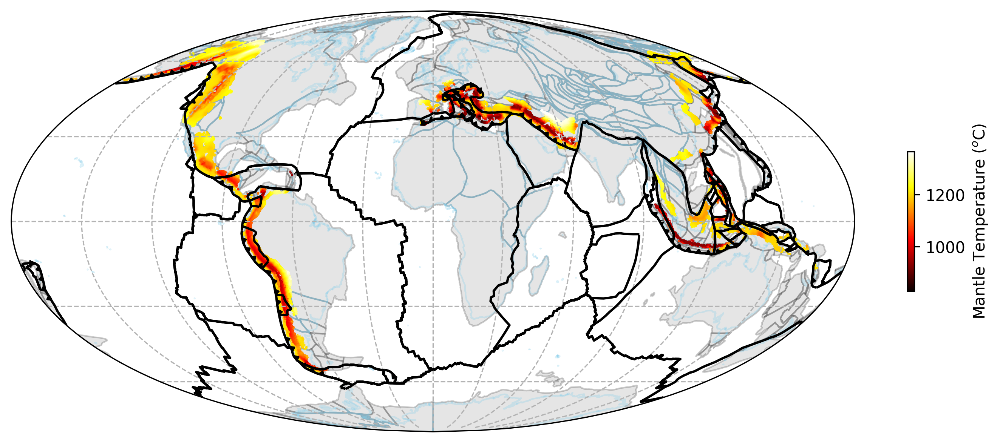

In [39]:
column='Mantle Temperature ($^o$C)'
kwaargs={'cmap':'hot','label':f'{column}','figsize':(12,8),'shrink':0.2,'markersize':0.1}
plotgdf(gdf_points,model=PK.model,quick=False,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Mantle Temperature.png")
plt.show()

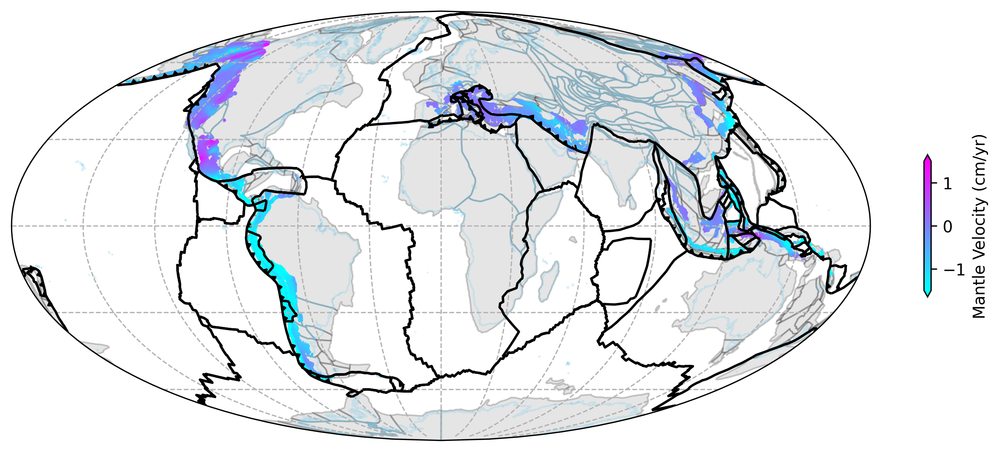

In [40]:
column='Mantle Velocity (cm/yr)'
kwaargs={'cmap':'cool','label':f'{column}','figsize':(12,8),'shrink':0.2,'vmin':-1.5,'vmax':1.5,'extend':'both','markersize':0.1}
plotgdf(gdf_points,model=PK.model,mollweide=True,quick=False,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Mantle Velocity.png")

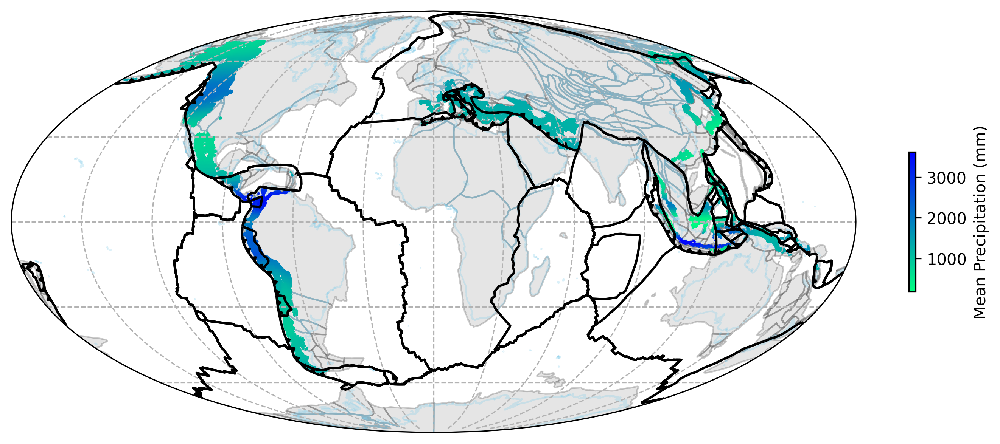

In [41]:
column='Mean Precipitation (mm)'
kwaargs={'cmap':'winter_r','label':f'{column}','figsize':(12,8),'shrink':0.2,'markersize':0.1}
plotgdf(gdf_points,model=PK.model,mollweide=True,quick=False,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Precipitation.png")

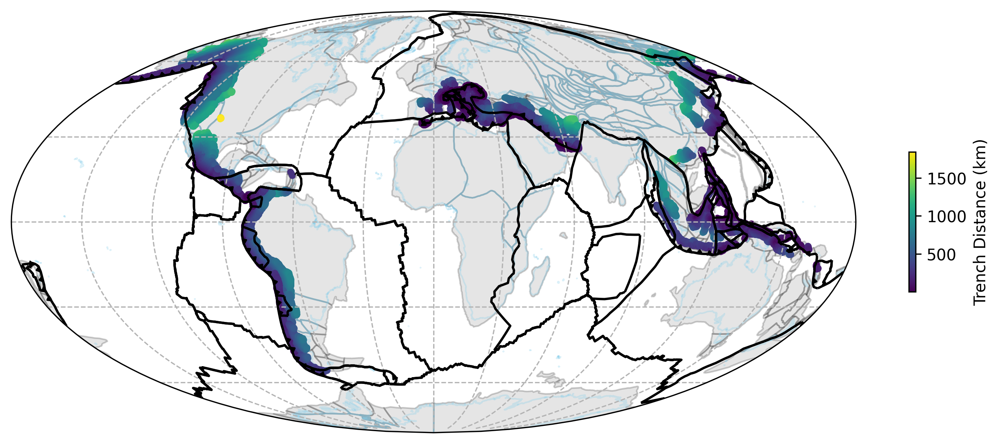

In [42]:
column='Trench Distance (km)'
kwaargs={'cmap':'viridis','label':f'{column}','figsize':(12,8),'shrink':0.2}
plotgdf(gdf_points,model=PK.model,mollweide=True,quick=False,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Trench Distance.png")
plt.show()

# Build a XAI model

In [ ]:
# features=featuresc.drop(columns=['Elevation (m)'])
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(featuresc.drop(columns=['Elevation (m)']), featuresc['Elevation (m)'], test_size=0.3, random_state=22)

interactions=[(0,1),(0,2),(0,3),(0,4),(0,5),(1,2),(2,4),(2,5)] ### all the pairs
XAI=EBMModel(features,interactions=interactions)
ebm=XAI.model
ebm.fit(X_train, y_train.to_numpy())
# Make predictions on the test set
y_pred = ebm.predict( X_test)

# Calculate the root mean squared error
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
print("Root Mean Squared Error:", rmse)

Root Mean Squared Error: 417.2913147292752


### Explained Variance Score

In [ ]:
ebm.score(X_test,y_test)

## Misfit Analysis: Visualising the Misfit  

In this step, we compare the reconstructed model output against observational or reference datasets.  
The **misfit** represents the difference (residuals) between predicted and observed values, providing a measure of model performance and accuracy.  
Visualising the misfit helps identify systematic biases, regional discrepancies, and overall reliability of the reconstruction.  


In [47]:
latitudes=TrainingData['Latitude']
longitudes= TrainingData['Longitude']
y_pred = ebm.predict(featuresc)
# Results=pd.DataFrame()
Results=featuresc.copy()
Results["Actual Elevation"]=featuresc['Elevation (m)']
Results["Latitude"]=latitudes
Results["Longitude"]=longitudes
Results["Predicted Elevation"]=y_pred
Results['Difference']=Results["Predicted Elevation"]-Results["Actual Elevation"]
Results_gdf=gpd.GeoDataFrame(Results,geometry=gpd.points_from_xy(longitudes,latitudes))
Results_gdf=Results_gdf.set_crs("EPSG:4326")

/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/interpret/utils/_clean_x.py:1332: UserWarning: Extra columns present in X that are not used by the model.


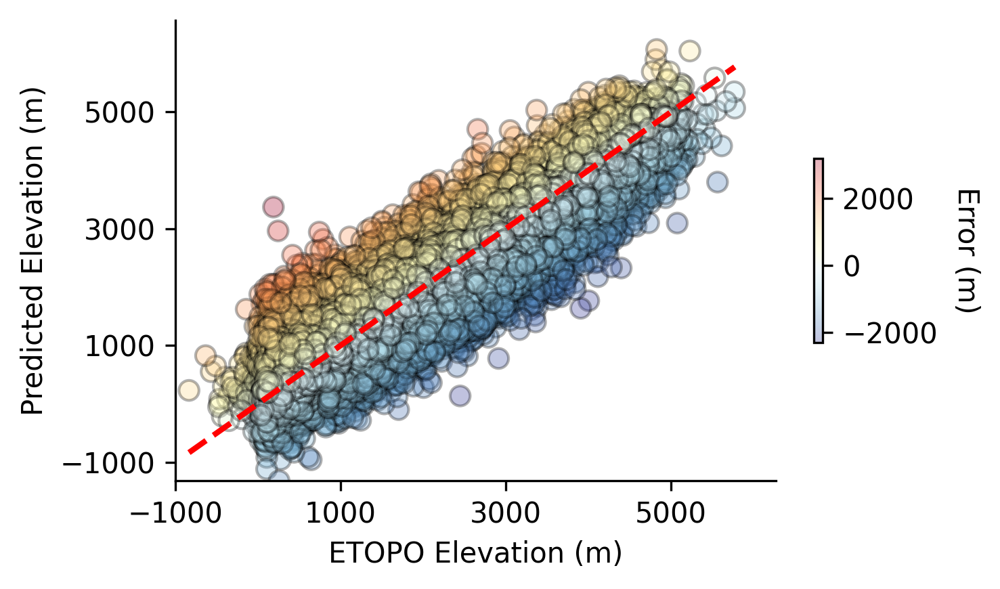

In [191]:
actual_elevation = Results_gdf["Actual Elevation"]
predicted_elevation = Results_gdf["Predicted Elevation"]

# # Calculate the point density
xy = np.vstack([actual_elevation, predicted_elevation])
z = gaussian_kde(xy)(xy)

# Create the plot
fig, ax = plt.subplots(figsize=(5, 3), dpi=300)

# Scatter plot with color mapping to density
sc = ax.scatter(actual_elevation, predicted_elevation, c=Results_gdf["Difference"], s=50, cmap='RdYlBu_r', edgecolor='k', alpha=0.3)

# Add a colorbar
cbar = plt.colorbar(sc, ax=ax,shrink=0.4)
cbar.set_label('Error (m)', rotation=270, labelpad=15)

# Plot the reference line (y=x)
ax.plot([min(actual_elevation), max(actual_elevation)], [min(actual_elevation), max(actual_elevation)], color='red', linestyle='--', linewidth=2)

# Labels and title
ax.set_xlabel('ETOPO Elevation (m)', fontsize=10)
ax.set_ylabel('Predicted Elevation (m)', fontsize=10)
# ax.set_title('Actual vs. Predicted Elevation', fontsize=16, weight='bold')

# Set axis limits and add grid
ax.set_xlim(min(actual_elevation), max(actual_elevation)+500)
ax.set_ylim(min(predicted_elevation), max(predicted_elevation)+500)
# ax.se
# ax.grid(True, linestyle='--', alpha=0.6)
ax.grid(False)
# Add legend
# ax.legend(loc='upper left', fontsize=12)
ax.xaxis.set_ticks(np.arange(-1000, 7000, 2000))
ax.yaxis.set_ticks(np.arange(-1000, 7000, 2000))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Misfit.png")
# Show plot

plt.show()


## Mountain-wise Data Analysis: Understanding Elevation at Active Margins  

In this step, we analyze elevation patterns of individual mountain systems located near active margins.  
The goal is to evaluate how processes at subduction zones influence the observed elevation distribution.  


In [192]:
# Define the groups and their symbols
groups = {
    'island arcs': 'o',   # Circle
    'noncollisional mountains': '^',   # Triangle
    'collisional mountains': 's'    # Rectangle
}
# vibrant blue
colorlist=["xkcd:lavender","xkcd:pink","xkcd:strong blue","xkcd:grapefruit","xkcd:neon purple","xkcd:bluish"]
# Define the colors for each group
group_colors = {
    'island arcs': colorlist,  # Distinct colors for island arcs

    'noncollisional mountains':colorlist,  # Distinct colors for noncollisional mountains
    'collisional mountains': colorlist  # Distinct colors for collisional mountains
    # 'noncollisional mountains': ['blue', 'dodgerblue', 'magenta', 'seagreen', 'brown', 'cyan'],  # Distinct colors for noncollisional mountains
    # 'collisional mountains': ['lime', 'slategray', 'coral', 'teal', 'indigo']  # Distinct colors for collisional mountains
}

# Define which mountains belong to which group
mountain_groups = {
    'Alaska-Yukon Ranges': 'noncollisional mountains',
    # 'Anatolian / Armenian Highlands': 'collisional mountains',
    'Balochistan Ranges': 'collisional mountains',
    'Caucasus Mountains': 'collisional mountains',
    'Central Andes': 'noncollisional mountains',
    'Hindu Kush': 'collisional mountains',
    'Iranian Plateau': 'collisional mountains',
    'Japanese Archipelago': 'island arcs',
    'Kamchatka Peninsula': 'island arcs',
    'Northern Andes': 'noncollisional mountains',
    'Pacific Coast Ranges':  'noncollisional mountains',
    'Solomon Islands': 'island arcs',
    'Lesser Antilles': 'island arcs',
    'South European Highlands': 'noncollisional mountains',
    'Southern Andes': 'noncollisional mountains',
       'Malay Archipelago':'island arcs'
}


In [193]:
filtered_df1=gpd.read_file(f"{DEFAULT_OUTPUT_CSV}/Filtered_GMBA_Hier_Lvl3.shp")
points_within=gpd.sjoin(Results_gdf,filtered_df1,how='left',predicate='within')
points_within=points_within[points_within['MapName'].isin(list(mountain_groups.keys()))]
# Example if you know the column names to include
mean_values = points_within.groupby(['MapName'])[['Actual Elevation']].mean()


In [194]:
# Initialize lists to store symbols and colors
symbols = []
colors = []

# Track color index for each group to cycle through colors
color_indices = {group: 0 for group in groups.keys()}

# Loop over the mean_values DataFrame and assign symbols and colors
for index in mean_values.index:
    mountain_group = mountain_groups[index]  # Find the group of the mountain
    symbol = groups[mountain_group]  # Get the symbol for the group
    
    # Get the color for the group and cycle through if needed
    color_list = group_colors[mountain_group]
    color_index = color_indices[mountain_group]
    color = color_list[color_index]
    
    # Update the color index for the next mountain in the same group
    color_indices[mountain_group] = (color_index + 1) % len(color_list)
    
    # Append symbol and color to respective lists
    symbols.append(symbol)
    colors.append(color)

# Add symbols and colors as columns to mean_values DataFrame
mean_values['Symbol'] = symbols
mean_values['Color'] = colors

# Display the updated DataFrame
print(mean_values)

                          Actual Elevation Symbol             Color
MapName                                                            
Alaska-Yukon Ranges             939.485046      ^     xkcd:lavender
Balochistan Ranges              874.018494      s     xkcd:lavender
Caucasus Mountains             1537.524658      s         xkcd:pink
Central Andes                  2747.279541      ^         xkcd:pink
Hindu Kush                     2313.749512      s  xkcd:strong blue
Iranian Plateau                1684.323486      s   xkcd:grapefruit
Japanese Archipelago            564.051331      o     xkcd:lavender
Kamchatka Peninsula             649.628174      o         xkcd:pink
Lesser Antilles                 204.602951      o  xkcd:strong blue
Malay Archipelago               623.573364      o   xkcd:grapefruit
Northern Andes                 1719.436890      ^  xkcd:strong blue
Pacific Coast Ranges            968.890015      ^   xkcd:grapefruit
Solomon Islands                 428.980682      

## Visualizing the Distribution and Mean Elevation of Various Mountains  

In this step, we examine the elevation characteristics of different mountain systems.  
Both the **distribution of elevation values** and the **mean elevation** are plotted to identify regional patterns and highlight contrasts across active margins.  


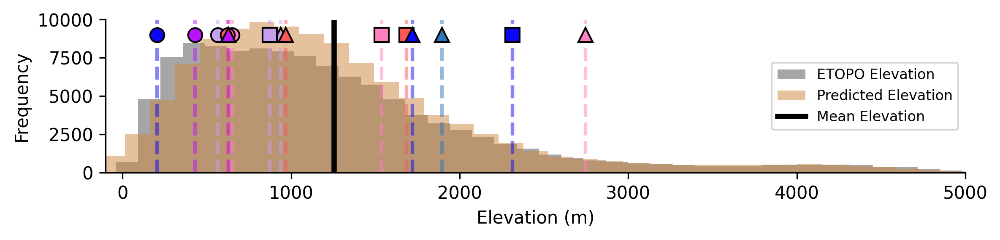

In [195]:

# Create a figure and axis
fig, ax = plt.subplots(figsize=(8, 2),dpi=300)  # Set the figure size

# Plot the histogram for Actual Elevation
ax.hist(
    Results_gdf["Actual Elevation"],
    bins=50,  # Number of bins
    alpha=0.7,  # Transparency level for overlap
    color='gray',  # Color for Actual Elevation
    # edgecolor='black',  # Edge color for clarity
    label='ETOPO Elevation'  # Label for legend
)

# Plot the histogram for Predicted Elevation
ax.hist(
    Results_gdf["Predicted Elevation"],
    bins=50,  # Ensure the same number of bins for comparison
    alpha=0.5,  # Slightly more transparent for overlap visualization
    color='peru',  # Color for Predicted Elevation
    # edgecolor='black',  # Edge color for clarity
    label='Predicted Elevation'  # Label for legend
)

# Overlay vertical lines at actual elevation values with corresponding colors and symbols
for index, row in mean_values.iterrows():
    # Extract values
    actual_elevation = row['Actual Elevation']
    color = row['Color']
    symbol = row['Symbol']
    
    # Plot the vertical line with symbol
    ax.axvline(
        x=actual_elevation,
        alpha=0.5,
        color=color,
        linestyle='--',
        linewidth=2,
        # label=f'{index} (Mean Elevation)'
    )
    
    # Overlay the symbol at the mean elevation value
    ax.plot(
        actual_elevation,  # X position
        9000,  # Y position (adjust as needed, here 0 to ensure it's visible)
        marker=symbol,
        color=color,
        markersize=8,
        markeredgecolor='k',
        # label=f'{index} Symbol'
    )

    # Extract values

color = row['Color']
symbol = row['Symbol']

# Plot the vertical line with symbol
ax.axvline(
    x=Results_gdf["Actual Elevation"].mean(),
    alpha=1,
    color='black',
    linestyle='-',
    linewidth=3,
    label=f'Mean Elevation'
)
    
ax.grid(False)
# Set axis labels
ax.set_xlabel('Elevation (m)', fontsize=10)
ax.set_ylabel('Frequency', fontsize=10)

# Set title
# ax.set_title('Comparison of Actual vs. Predicted Elevation', fontsize=15)

# Add a legend to differentiate the histograms
ax.legend(fontsize=8,loc='center right')
ax.grid(False)
# Turn off top and right spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.set_ylim([0,10000])
ax.set_xlim([-100,5000])
# Save the figure in high resolution
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/elevation_comparison_histogram.png", dpi=300)

# Show the plot
plt.show()


In [196]:
mountain_names=mean_values.index
# Organize mountain names by group
sorted_mountains = {
    'island arcs': [name for name, group in mountain_groups.items() if group == 'island arcs'],
    'noncollisional mountains': [name for name, group in mountain_groups.items() if group == 'noncollisional mountains'],
    'collisional mountains': [name for name, group in mountain_groups.items() if group == 'collisional mountains']
}

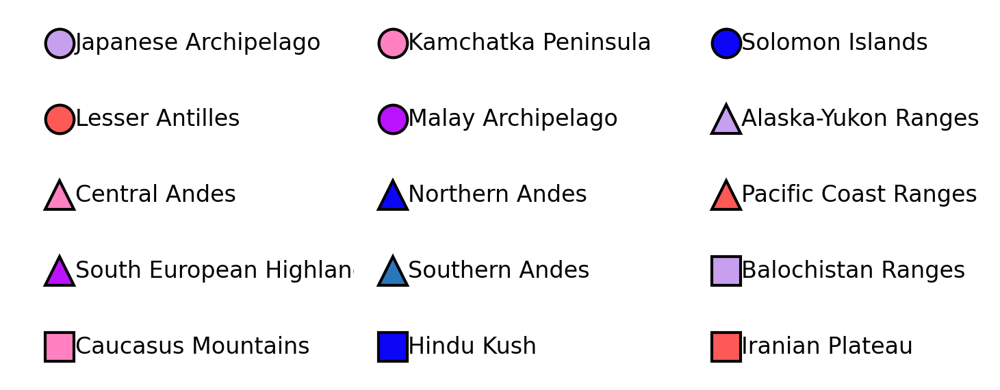

In [197]:

# Create the figure and axes
fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(4.7, 2), dpi=300)
axes = axes.flatten()  # Flatten the 2D array of axes

# Plot each mountain name, symbol, and color
idx = 0
for group, names in sorted_mountains.items():
    symbol = groups[group]
    colors = group_colors[group]
    for name, color in zip(names, colors):
        axes[idx].plot(
            0.5,  # X position
            0.5,  # Y position
            marker=symbol,
            color=color,
            markersize=10,
            markeredgecolor='black',  # Outline color
            markeredgewidth=1,  # Outline width
            linestyle='None'
        )
        axes[idx].text(0.7, 0.5, name, ha='left', va='center', fontsize=8)
        axes[idx].set_xlim(0, 1.4)
        axes[idx].set_ylim(0, 1)
        axes[idx].set_xticks([])
        axes[idx].set_yticks([])
        axes[idx].spines['top'].set_visible(False)
        axes[idx].spines['right'].set_visible(False)
        axes[idx].spines['left'].set_visible(False)
        axes[idx].spines['bottom'].set_visible(False)
        idx += 1

# Adjust layout
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/mountain_symbols_panel.png", dpi=300, bbox_inches='tight')
plt.show()


## Data Analysis: Mean Parameters and Elevation for Each Mountain  

This step summarizes the results by computing **mean values of all key parameters** for each mountain system.  
The output is presented as:  
- A **table** showing the average subduction/mantle/paleoclimate parameters for each mountain.  
- The **corresponding mean elevation**, allowing comparison between geodynamic controls and surface expression.  


In [198]:
Results_gdf['Difference']=Results_gdf["Actual Elevation"]-Results_gdf["Predicted Elevation"]

GMBA_file=PARAMS['InputFiles']['Area_of_Interest']
GMBA=gpd.read_file(GMBA_file) ## this is a comprehensive database of all the mountains. 
## more details https://www.earthenv.org/mountains
Arcs=GMBA[GMBA['Hier_Lvl']==3].copy()

In [199]:
gdf_points=gpd.GeoDataFrame(featuresc,geometry=gpd.points_from_xy(longitudes,latitudes))
gdf_points=gdf_points.set_crs("EPSG:4326")
gdf_points = gpd.sjoin(gdf_points, Arcs, predicate='within')
columns_to_exclude = ['geometry', 'index_right', 'GMBA_V2_ID',
       'GMBA_V1_ID', 'WikiDataUR', 'MapUnit', 'Hier_Lvl', 'Feature',
       'Area', 'Perimeter', 'Elev_Low', 'Elev_High', 'Path', 'Path_ID',
       'Level_01', 'Level_02', 'Level_03', 'Level_04', 'Level_05', 'Level_06',
       'Level_07', 'Level_08', 'Level_09', 'Level_10', 'Select_300',
       'Countries', 'CountryISO', 'DBaseName', 'AsciiName', 'Name_AR',
       'Name_DE', 'Name_EN', 'Name_ES', 'Name_FR', 'Name_PT', 'Name_RU',
       'Name_ZH', 'LocalNames', 'ColorAll', 'ColorBasic', 'Color300']
parameter_mts = gdf_points.drop(columns_to_exclude, axis=1).groupby('MapName').mean()
# parameter_mts = parameter_mts.select_dtypes(include='number').groupby('MapName').mean()


In [200]:
parameter_mts

,Elevation (m),Subduction Flux (km$^3$/yr),Trench Migration Rate (cm/yr),Trench Distance (km),Mantle Temperature ($^o$C),Mantle Velocity (cm/yr),Mean Precipitation (mm)
MapName,,,,,,,
Alaska-Yukon Ranges,939.485046,0.017556,-0.637512,779.695691,1234.395996,-0.027484,927.542957
Anatolian / Armenian Highlands,1397.450562,0.009380,1.277826,299.370808,1122.470825,-0.308083,1267.290962
Balochistan Ranges,874.018494,0.029792,1.252919,141.158017,1157.300903,-0.444439,1361.077075
Bismarck Archipelago,586.890869,0.052924,-1.861130,96.996854,1193.160767,-1.568917,1494.869090
Caucasus Mountains,1537.524658,0.010988,2.318132,521.071338,1123.321655,-0.644777,1304.760001
Central America Volcanic Arc,296.989349,0.059949,0.541984,173.575068,1205.198730,-1.928504,1916.332933
Central Andes,2747.279541,0.075140,0.579013,427.623330,1110.885864,-1.569384,1896.638967
Central European Highlands,1217.563110,0.001026,0.497729,75.091341,1100.491089,0.017333,1349.680914
Chorotega Highlands*,896.395264,0.030919,1.247051,127.637560,1198.239502,-2.525769,2861.980019


# Predicted vs. Actual Elevation: Geospatial Misfit


In [201]:
k=ebm.explain_local(featuresc, featuresc['Elevation (m)'])

/Users/ssin4735/miniforge3/envs/EBMTest311/lib/python3.11/site-packages/interpret/utils/_clean_x.py:1332: UserWarning:

Extra columns present in X that are not used by the model.



In [202]:
explanation_dic=ebm.explain_global().__dict__
names=explanation_dic["_internal_obj"]['overall']['names']

In [203]:
explanation_dic_local=ebm.explain_local(featuresc, featuresc['Elevation (m)']).__dict__

In [204]:
local_exp=pd.DataFrame()
new_rows_list=[]
predicted=[]
actual=[]
# Assuming you have a loop to iterate over different values of i
for i in range(len(explanation_dic_local["_internal_obj"]['specific'])):
    column_names = explanation_dic_local["_internal_obj"]['specific'][i]['names']
    values = explanation_dic_local["_internal_obj"]['specific'][i]['scores']
    
    actual.append(explanation_dic_local["_internal_obj"]['specific'][i]['perf']['actual'])
    predicted.append(explanation_dic_local["_internal_obj"]['specific'][i]['perf']['predicted'])
    
    name_value_dict = dict(zip(column_names, values))
    new_rows_list.append(name_value_dict)
local_exp = pd.DataFrame(new_rows_list)
# local_exp=local_exp/1495  

    

In [205]:
local_exp['Actual Elevation']=actual
local_exp['Predicted Elevation']=predicted
# local_exp['Error']=abs(local_exp['Smoothed Elevation']-local_exp['Predicted'])
local_exp_gdf=gpd.GeoDataFrame(local_exp,geometry=gpd.points_from_xy(longitudes,latitudes))
local_exp_gdf=local_exp_gdf.set_crs("epsg:4326")

In [206]:

points_within_arcs = gpd.sjoin(local_exp_gdf, Arcs, predicate='within')

local_exp_mts = points_within_arcs.drop(columns_to_exclude, axis=1).groupby('MapName').mean()

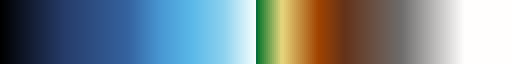

In [207]:
##### cpt to matplotlib
from pyDTDM.utils import readcpt

# Generate PyGMT 'geo' colormap
pygmt.makecpt(cmap="geo", series=[-8000, 8000, 1], output="geo.cpt")

matplotlib_cmap=readcpt("geo.cpt")

matplotlib_cmap

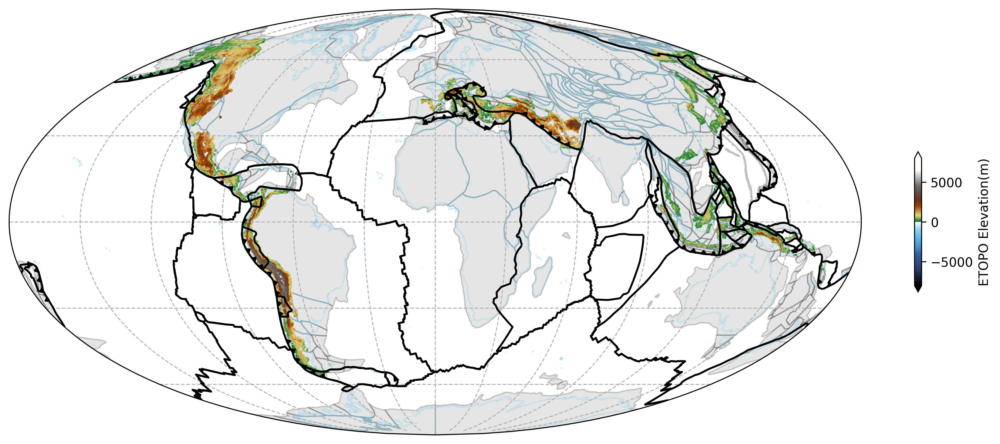

In [208]:
column='Actual Elevation'
kwaargs={'cmap':matplotlib_cmap,'label':f'ETOPO Elevation(m)','figsize':(12,8),'shrink':0.2,'vmin':-8000,'vmax':8000,'markersize':0.1,'extend':'both'}
ax=plotgdf(local_exp_gdf,mollweide=True,quick=False,column=column,gplot=gplot,cbar=True,**kwaargs)

plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Actual Elevation_1.png")
plt.show()

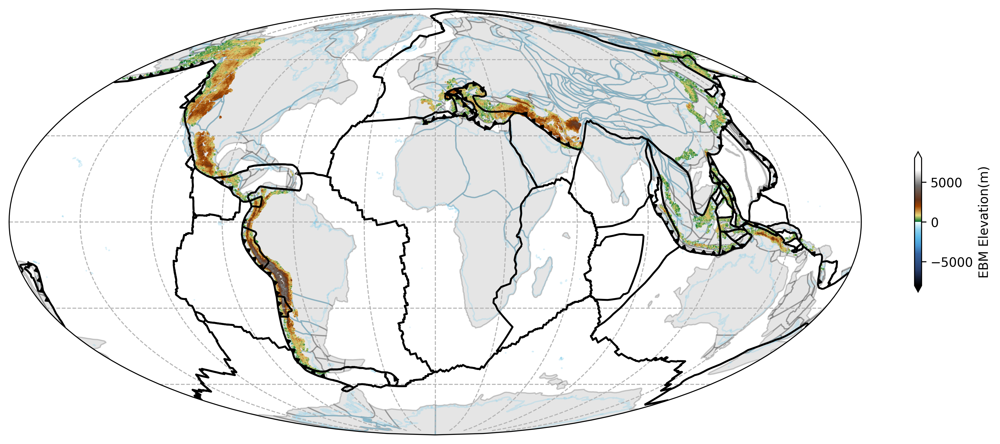

In [209]:
column='Predicted Elevation'
kwaargs={'cmap':matplotlib_cmap,'label':f'EBM Elevation(m)','figsize':(12,8),'shrink':0.2,'vmin':-8000,'vmax':8000,'markersize':0.1,'extend':'both'}
ax=plotgdf(local_exp_gdf,mollweide=True,quick=False,column=column,gplot=gplot,cbar=True,**kwaargs)
plt.tight_layout()

plt.savefig(f"{OUTPUT_FOLDER}/Figure/Predicted Elevation_1.png")
plt.show()

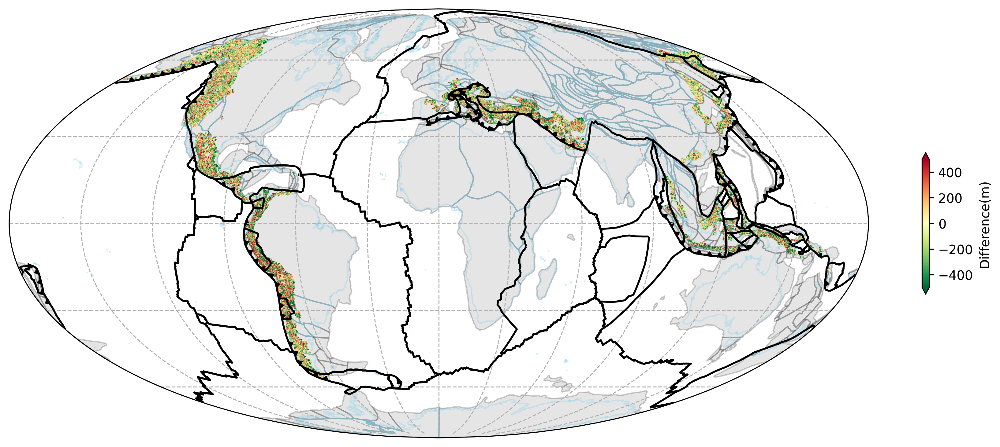

In [210]:
local_exp_gdf['Difference']=local_exp_gdf['Actual Elevation']-local_exp_gdf['Predicted Elevation']
column='Difference'
kwaargs={'cmap':"RdYlGn_r",'label':f'Difference(m)','figsize':(12,8),'shrink':0.2,'vmin':-500,'vmax':500,'markersize':0.1,'extend':'both'}
ax=plotgdf(local_exp_gdf,mollweide=True,quick=False,column=column,gplot=gplot,cbar=True,**kwaargs)
# topo_coarse.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=6000,vmin=-11000,cmap=Etopo_REED, add_colorbar=False,robust=True,alpha=1.0)

# ax=plotgdf(local_exp_gdf,model=PK.model,mollweide=True,column=column,cbar=True,**kwaargs)
plt.tight_layout()
# topo_coarse.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=6000,vmin=-11000,cmap=Etopo_REED, add_colorbar=False,robust=True,alpha=1.0)

plt.savefig(f"{OUTPUT_FOLDER}/Figure/Difference Elevation_1.png")
plt.show()

## Geospatial Explanation

Using the EBM, we estimate the geospatial contribution of each parameter to elevation,  
while keeping all other parameters constant.


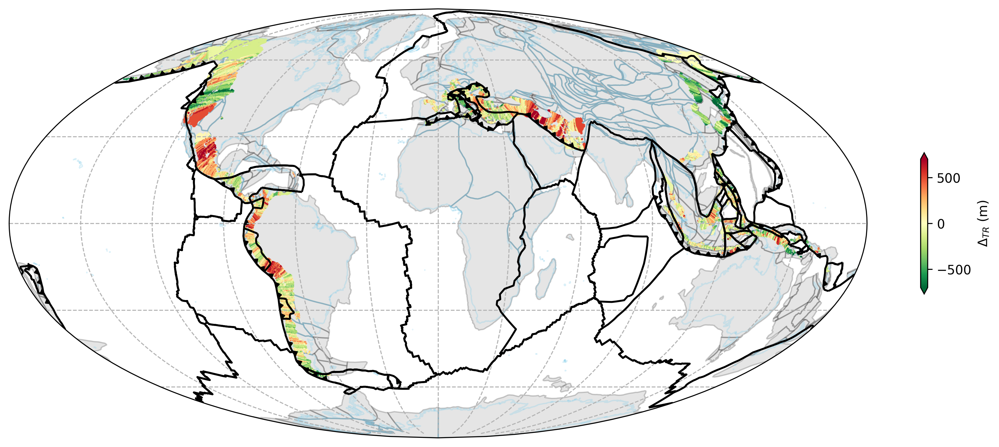

In [211]:
column='Trench Migration Rate (cm/yr)'
kwaargs={'cmap':"RdYlGn_r",'label':f"$ \mathregular{{\Delta}}_{{TR}}$ (m)",'figsize':(12,8),'shrink':0.2,'vmin':-700,'vmax':700,'markersize':0.1,'extend':'both'}
ax=plotgdf(local_exp_gdf,mollweide=True,quick=False,column=column,gplot=gplot,cbar=True,**kwaargs)
# topo_coarse.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=6000,vmin=-11000,cmap=Etopo_REED, add_colorbar=False,robust=True,alpha=1.0)

# ax=plotgdf(local_exp_gdf,model=PK.model,mollweide=True,column=column,cbar=True,**kwaargs)
plt.tight_layout()
# topo_coarse.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=6000,vmin=-11000,cmap=Etopo_REED, add_colorbar=False,robust=True,alpha=1.0)

plt.savefig(f"{OUTPUT_FOLDER}/Figure/Explaination_Trench_Migration_Rate.png")
plt.show()

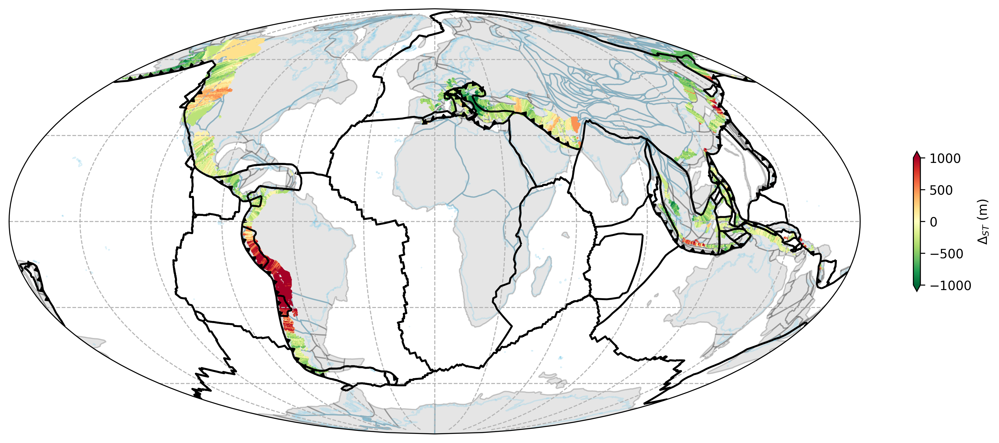

In [212]:
column="Subduction Flux (km$^3$/yr)"
kwaargs={'cmap':"RdYlGn_r",'label':f"$ \mathregular{{\Delta}}_{{ST}}$ (m)",'figsize':(12,8),'shrink':0.2,'markersize':0.1,'vmin':-1000,'vmax':1000,'extend':'both'}
# topo_coarse.plot(ax=ax, transform=ccrs.PlateCarree(), vmax=6000,vmin=-11000,cmap='grey', add_colorbar=False,robust=True,alpha=1.0)
plotgdf(local_exp_gdf,quick=False,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Explanation_Subduction_Flux_Rate.png")
plt.show()

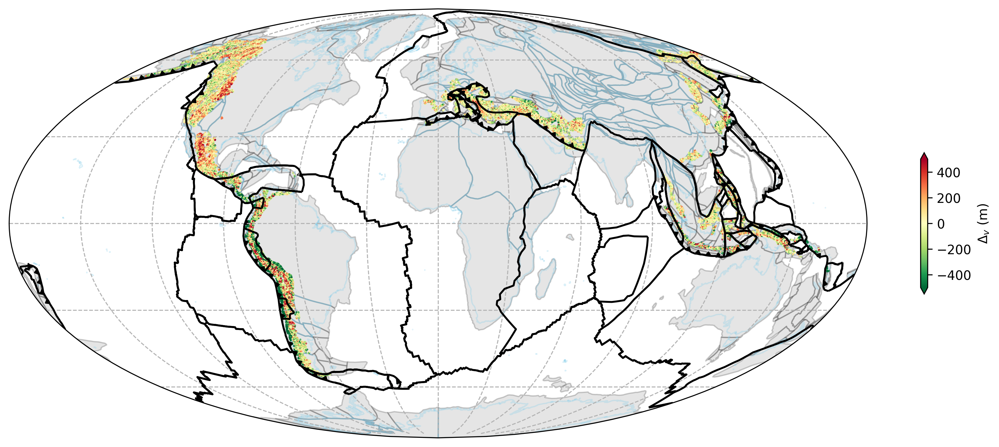

In [213]:
column="Mantle Velocity (cm/yr)"
kwaargs={'cmap':"RdYlGn_r",'label':f"$ \mathregular{{\Delta}}_{{v}}$ (m)",'figsize':(12,8),'shrink':0.2,'vmin':-500,'vmax':500,'extend':'both','markersize':0.1,}
plotgdf(local_exp_gdf,quick=False,mollweide=True,gplot=gplot,column=column,cbar=True,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Explanation_Vertical_Mantle_Flow.png")
plt.show()

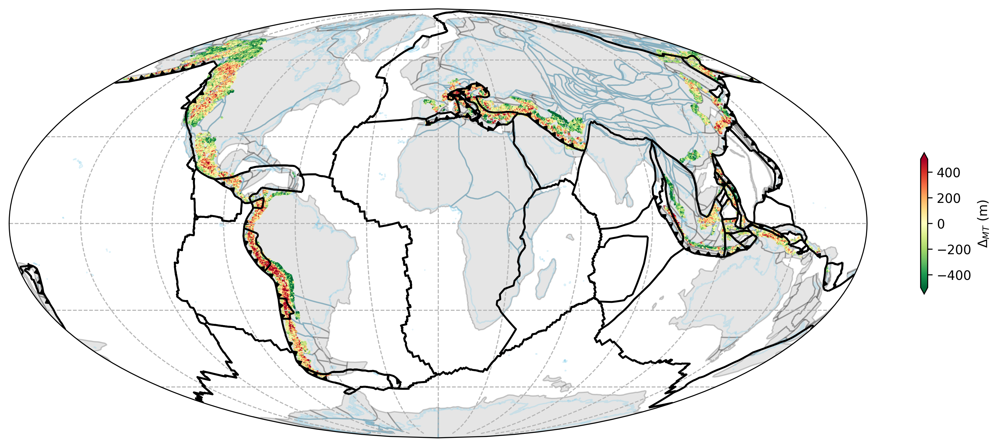

In [214]:
column='Mantle Temperature ($^o$C)'
kwaargs={'cmap':"RdYlGn_r",'label':f"$ \mathregular{{\Delta}}_{{MT}}$ (m)",'figsize':(12,8),'shrink':0.2,'markersize':0.1,'vmin':-500,'vmax':500,'extend':'both'}
plotgdf(local_exp_gdf,quick=False,mollweide=True,column=column,gplot=gplot,cbar=True,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Explanation_Mantle_Temperature.png")
plt.show()

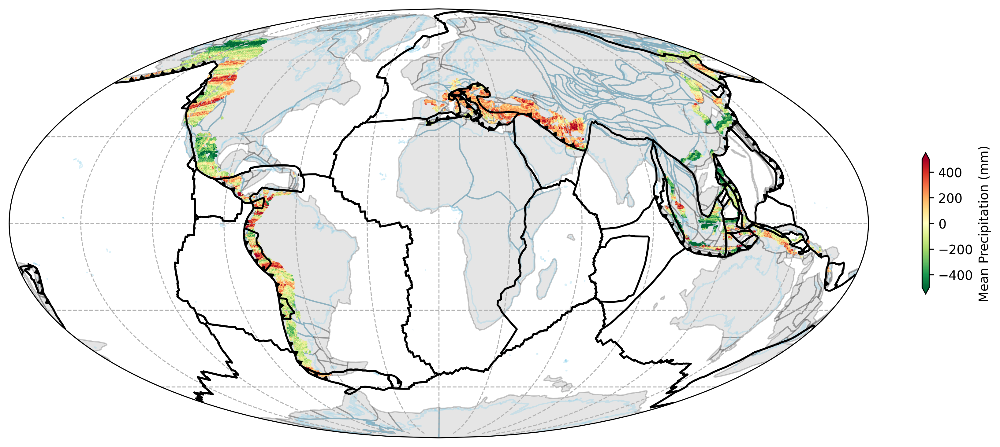

In [215]:
column='Mean Precipitation (mm)'
kwaargs={'cmap':"RdYlGn_r",'label':f'{column}','figsize':(12,8),'shrink':0.2,'vmin':-500,'vmax':500,'extend':'both','markersize':0.1}
plotgdf(local_exp_gdf,quick=False,mollweide=True,column=column,gplot=gplot,cbar=True,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Explanation_Precipitation.png")
plt.show()

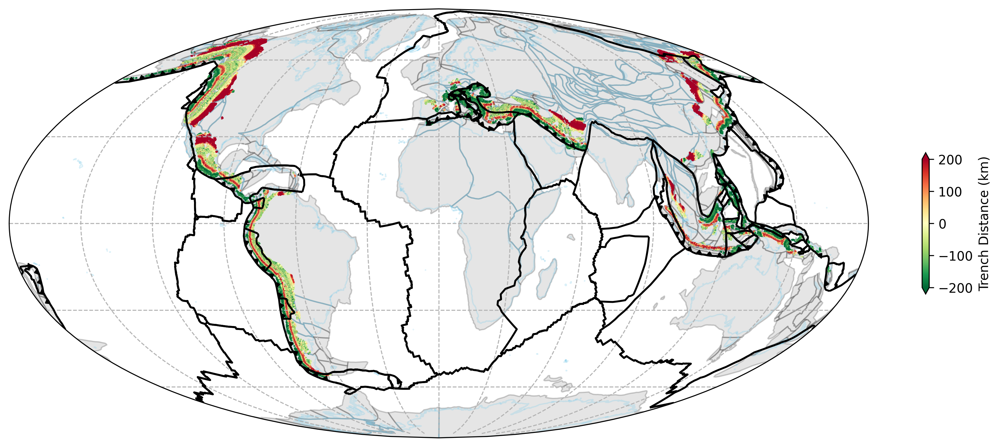

In [216]:
column='Trench Distance (km)'
kwaargs={'cmap':"RdYlGn_r",'label':f'{column}','figsize':(12,8),'shrink':0.2,'vmin':-200,'vmax':200,'extend':'both','markersize':0.1}
plotgdf(local_exp_gdf,quick=False,mollweide=True,column=column,gplot=gplot,cbar=True,**kwaargs)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Explanation_TD.png")
plt.show()

## Shape Functions Derived from EBM Analysis

Shape functions describe how elevation responds to variations in individual parameters  
within the Energy Balance Model (EBM), while keeping other parameters constant.  
They help visualize the sensitivity of elevation to each contributing factor.


In [217]:
mts_list=['Alaska-Yukon Ranges',
       'Balochistan Ranges',

       'Caucasus Mountains',
       'Central Andes',
    
       'Hindu Kush', 

       'Iranian Plateau', 
       'Japanese Archipelago', 
       'Kamchatka Peninsula',

       'Lesser Antilles', 
       'Malay Archipelago',
 
       'Northern Andes', 
       'Pacific Coast Ranges',

       'Solomon Islands',
       # 'South China Mountains',
       'South European Highlands',
       # 'Southeast European Highlands', 
       'Southern Andes', 

        ]

island arcs
noncollisional mountains
collisional mountains


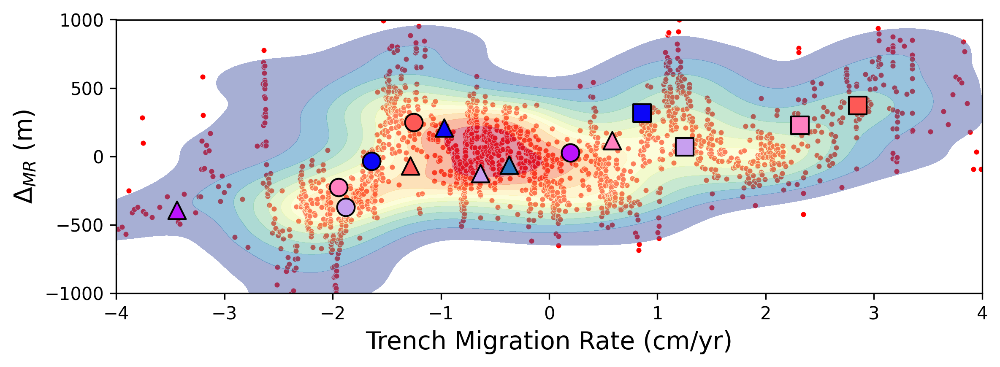

In [238]:

i=1
# Define the groups and their symbols


fig, ax = plt.subplots(figsize=[8, 3], dpi=300)
name = names[i]
x = explanation_dic["_internal_obj"]['specific'][i]['names'][:-1]
y = explanation_dic["_internal_obj"]['specific'][i]['scores']

sns.scatterplot(x=x, y=y, alpha=1.0, color='red', s=10, ax=ax)
sns.kdeplot(x=x, y=y, fill=True, levels=12, cmap="Spectral_r", bw_adjust=1, alpha=0.5, ax=ax)

# Create a color counter for each group
color_counters = {group: 0 for group in groups.keys()}

# Create legend handles for each group and their individual mountains
legend_handles = {group: [] for group in groups.keys()}

for mountain_name, group in mountain_groups.items():
    x = parameter_mts.loc[mountain_name, 'Trench Migration Rate (cm/yr)']
    y = local_exp_mts.loc[mountain_name, 'Trench Migration Rate (cm/yr)']
    # Get distinct color for each name within the group
    colors = group_colors[group]
    counter = color_counters[group]
    color = colors[counter % len(colors)]
    
    # Increment the counter for the next mountain in the group
    color_counters[group] += 1
    
    # Modify the mountain name to have only the first letter of each word capitalized
    mountain_name = ' '.join(word.capitalize() for word in mountain_name.split())
    
    # Plot the point with the appropriate color and symbol
    ax.scatter(x, y, color=color, edgecolor='black', marker=groups[group], s=100, label=mountain_name)
    legend_handles[group].append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor=color, markeredgecolor='black', markersize=7, label=mountain_name))

# Combine handles into a final legend list
final_handles = []
for group, items in legend_handles.items():
    print(group)
    # Add a dummy handle for the group
    final_handles.append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor='gray', markeredgecolor='black', markersize=7, label=f'{group}'))
    # Add individual items under the group
    final_handles.extend(items)

indices_to_remove = [0, 6, 13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by

indices_to_remove = [0, 6,13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by index
final_handles= [item for index, item in enumerate(final_handles) if index not in indices_to_remove]

# Create custom legend with grouped and individual entries
# plt.legend(handles=final_handles, loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=3, fontsize=6)

# Set x and y limits
plt.xlim([-4, 4])
plt.ylim([-1000, 1000])
plt.yticks(np.linspace(-1000, 1000, num=5))
# Set labels
ax.set_xlabel(f"Trench Migration Rate (cm/yr)",fontsize=14)
ax.set_ylabel(f"$ \mathregular{{\Delta}}_{{MR}}$ (m)",fontsize=14)
ax.grid(False)
# Adjust layout and show the plot
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Trench Migration Rate.png")
plt.show()


island arcs
noncollisional mountains
collisional mountains


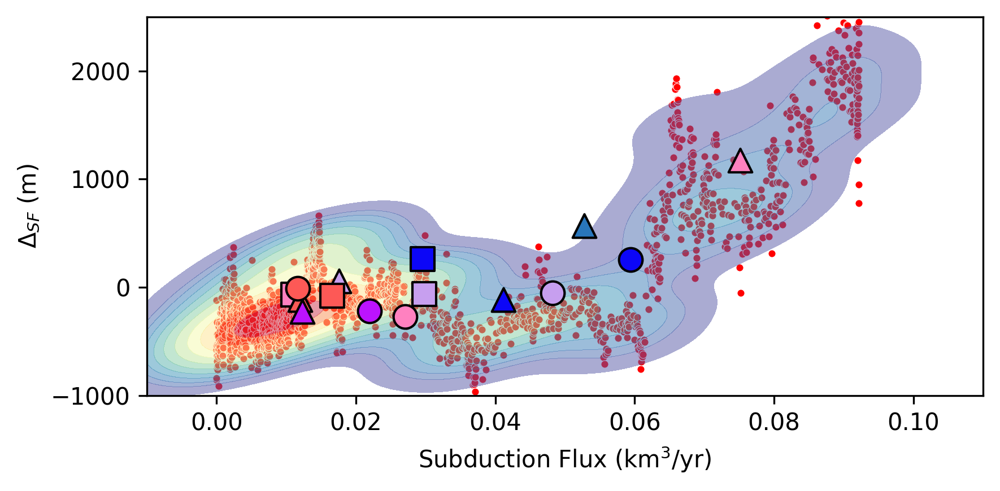

In [244]:

i = 0

# Prepare the plot
fig, ax = plt.subplots(figsize=[6, 3], dpi=300)
name = names[i]
x = explanation_dic["_internal_obj"]['specific'][i]['names'][:-1]
y = explanation_dic["_internal_obj"]['specific'][i]['scores']

sns.scatterplot(x=x, y=y, alpha=1.0, color='red', s=10, ax=ax)
sns.kdeplot(x=x, y=y, fill=True, levels=12, cmap="Spectral_r", bw_adjust=1, alpha=0.5, ax=ax)

# Create a color counter for each group
color_counters = {group: 0 for group in groups.keys()}

# Create legend handles for each group and their individual mountains
legend_handles = {group: [] for group in groups.keys()}

for mountain_name, group in mountain_groups.items():
    x = parameter_mts.loc[mountain_name, 'Subduction Flux (km$^3$/yr)']
    y = local_exp_mts.loc[mountain_name, 'Subduction Flux (km$^3$/yr)']
    # Get distinct color for each name within the group
    colors = group_colors[group]
    counter = color_counters[group]
    color = colors[counter % len(colors)]
    
    # Increment the counter for the next mountain in the group
    color_counters[group] += 1
    
    # Modify the mountain name to have only the first letter of each word capitalized
    mountain_name = ' '.join(word.capitalize() for word in mountain_name.split())
    
    # Plot the point with the appropriate color and symbol
    ax.scatter(x, y, color=color, edgecolor='black', marker=groups[group], s=100, label=mountain_name)
    legend_handles[group].append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor=color, markeredgecolor='black', markersize=7, label=mountain_name))

# Combine handles into a final legend list
final_handles = []
for group, items in legend_handles.items():
    print(group)
    # Add a dummy handle for the group
    final_handles.append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor='gray', markeredgecolor='black', markersize=7, label=f'{group}'))
    # Add individual items under the group
    final_handles.extend(items)

indices_to_remove = [0, 6, 13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by index
final_handles = [item for index, item in enumerate(final_handles) if index not in indices_to_remove]

# Set x and y limits
ax.set_xlim([-0.01, 0.11])  # Uncomment and adjust if needed
ax.set_ylim([-1000, 2500])
ax.set_yticks(np.linspace(-1000, 2000, num=4))

# Set labels
ax.set_xlabel(f"Subduction Flux (km$^3$/yr)")
ax.set_ylabel(f"$ \mathregular{{\Delta}}_{{SF}}$ (m)")

# Enable or disable the grid using ax object
# ax.grid(True)  # Turn on the grid
ax.grid(False)  # Turn off the grid

# Adjust layout and show the plot
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/SF.png")
plt.show()


island arcs
noncollisional mountains
collisional mountains


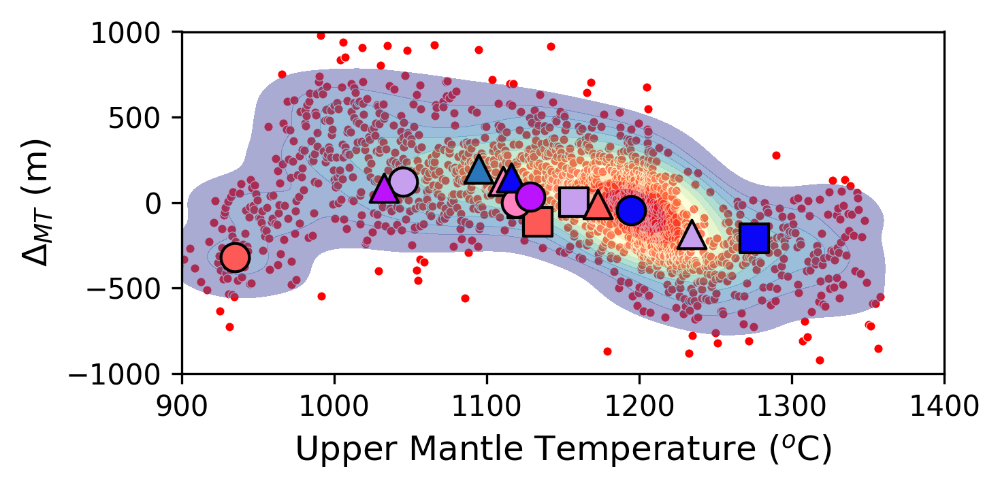

In [229]:


i=3



# Prepare the plot
plt.figure(figsize=[5, 2.5], dpi=300)
name = names[i]
x = explanation_dic["_internal_obj"]['specific'][i]['names'][:-1]
y = explanation_dic["_internal_obj"]['specific'][i]['scores']

sns.scatterplot(x=x, y=y, alpha=1.0, color='red', s=10)
sns.kdeplot(x=x, y=y, fill=True, levels=12, cmap="Spectral_r", bw_adjust=1, alpha=0.5)

# Create a color counter for each group
color_counters = {group: 0 for group in groups.keys()}

# Create legend handles for each group and their individual mountains
legend_handles = {group: [] for group in groups.keys()}

for mountain_name, group in mountain_groups.items():
    x = parameter_mts.loc[mountain_name, 'Mantle Temperature ($^o$C)']
    y = local_exp_mts.loc[mountain_name, 'Mantle Temperature ($^o$C)']
    # Get distinct color for each name within the group
    colors = group_colors[group]
    counter = color_counters[group]
    color = colors[counter % len(colors)]
    
    # Increment the counter for the next mountain in the group
    color_counters[group] += 1
    
    # Modify the mountain name to have only the first letter of each word capitalized
    mountain_name = ' '.join(word.capitalize() for word in mountain_name.split())
    
    # Plot the point with the appropriate color and symbol
    plt.scatter(x, y, color=color, edgecolor='black', marker=groups[group], s=100, label=mountain_name)
    legend_handles[group].append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor=color, markeredgecolor='black', markersize=7, label=mountain_name))

# Combine handles into a final legend list
final_handles = []
for group, items in legend_handles.items():
    print(group)
    # Add a dummy handle for the group
    final_handles.append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor='gray', markeredgecolor='black', markersize=7, label=f'{group}'))
    # Add individual items under the group
    final_handles.extend(items)

indices_to_remove = [0, 6,13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by index
final_handles= [item for index, item in enumerate(final_handles) if index not in indices_to_remove]

# Create custom legend with grouped and individual entries
# plt.legend(handles=final_handles, loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=3, fontsize=6)

# Set x and y limits
plt.xlim([900,1400])
plt.ylim([-1000, 1000])
plt.yticks(np.linspace(-1000, 1000, num=5))
# Set labels
plt.xlabel('Upper Mantle Temperature ($^o$C)', fontsize=12)
plt.ylabel(f"$ \mathregular{{\Delta}}_{{MT}}$ (m)", fontsize=12)
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/MantleTemp.png")
# Adjust layout and show the plot

plt.show()


island arcs
noncollisional mountains
collisional mountains


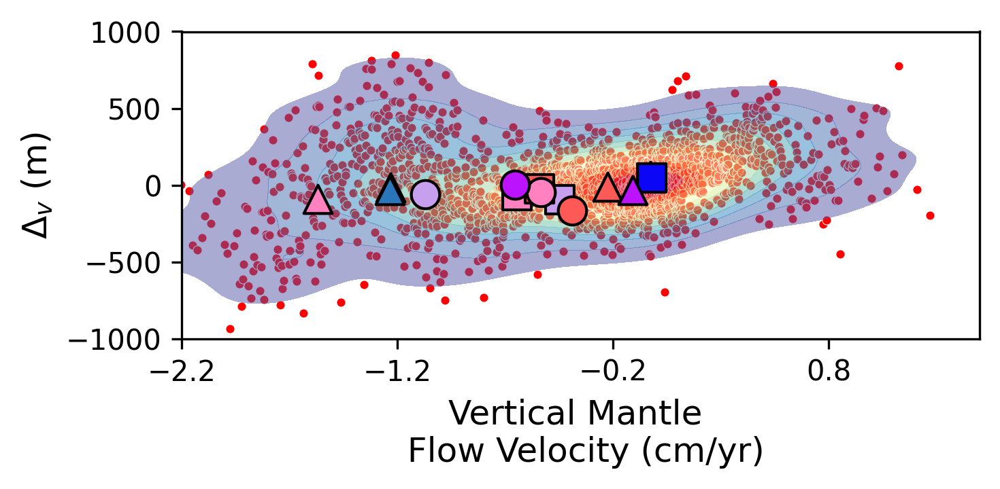

In [236]:


i=4

# Prepare the plot
plt.figure(figsize=[5, 2.5], dpi=300)
name = names[i]
x = explanation_dic["_internal_obj"]['specific'][i]['names'][:-1]
y = explanation_dic["_internal_obj"]['specific'][i]['scores']

sns.scatterplot(x=x, y=y, alpha=1.0, color='red', s=10)
sns.kdeplot(x=x, y=y, fill=True, levels=12, cmap="Spectral_r", bw_adjust=1, alpha=0.5)

# Create a color counter for each group
color_counters = {group: 0 for group in groups.keys()}

# Create legend handles for each group and their individual mountains
legend_handles = {group: [] for group in groups.keys()}

for mountain_name, group in mountain_groups.items():
    x = parameter_mts.loc[mountain_name, 'Mantle Velocity (cm/yr)']
    y = local_exp_mts.loc[mountain_name,  'Mantle Velocity (cm/yr)']
    # Get distinct color for each name within the group
    colors = group_colors[group]
    counter = color_counters[group]
    color = colors[counter % len(colors)]
    
    # Increment the counter for the next mountain in the group
    color_counters[group] += 1
    
    # Modify the mountain name to have only the first letter of each word capitalized
    mountain_name = ' '.join(word.capitalize() for word in mountain_name.split())
    
    # Plot the point with the appropriate color and symbol
    plt.scatter(x, y, color=color, edgecolor='black', marker=groups[group], s=100, label=mountain_name)
    legend_handles[group].append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor=color, markeredgecolor='black', markersize=7, label=mountain_name))

# Combine handles into a final legend list
final_handles = []
for group, items in legend_handles.items():
    print(group)
    # Add a dummy handle for the group
    final_handles.append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor='gray', markeredgecolor='black', markersize=7, label=f'{group}'))
    # Add individual items under the group
    final_handles.extend(items)

indices_to_remove = [0, 6,13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by index
final_handles= [item for index, item in enumerate(final_handles) if index not in indices_to_remove]

# Create custom legend with grouped and individual entries
# plt.legend(handles=final_handles, loc='upper center', bbox_to_anchor=(0.5, -0.2), ncol=3, fontsize=6)

# Set x and y limits
plt.xlim([-2,1.5])
plt.ylim([-1000, 1000])
plt.xticks(np.arange(-2.2, 1,1))
plt.yticks(np.linspace(-1000, 1000, num=5))
# Set labels
plt.xlabel(f"Vertical Mantle \n Flow Velocity (cm/yr)", fontsize=12)
plt.ylabel(f"$ \mathregular{{\Delta}}_{{v}}$ (m)", fontsize=12)

# Adjust layout and show the plot
plt.tight_layout()
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Mantlev.png")
plt.show()


island arcs
noncollisional mountains
collisional mountains


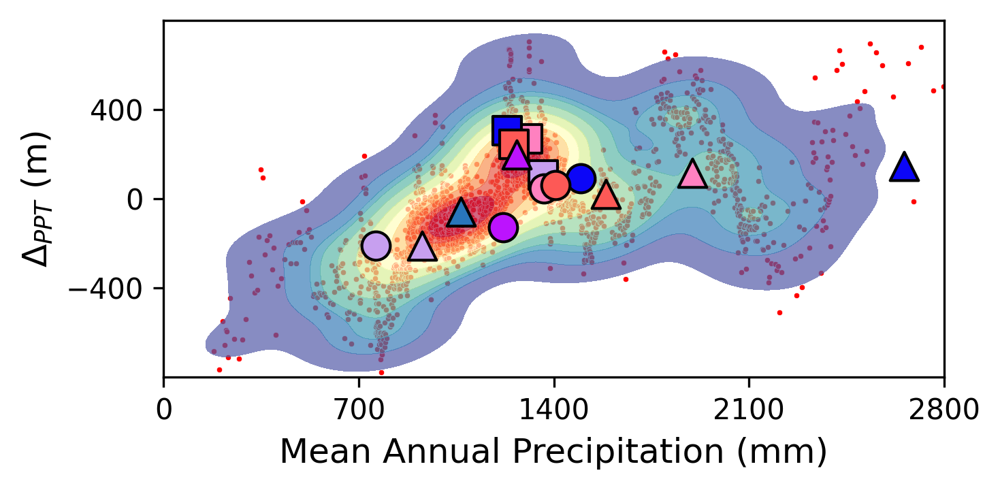

In [231]:
# plt.figure(figsize=[12,6])
i = 5
plt.figure(figsize=[5,2.5], dpi=300)
# name = names[i]
x = explanation_dic["_internal_obj"]['specific'][i]['names'][:-1]
y = explanation_dic["_internal_obj"]['specific'][i]['scores']
# sns.kdeplot(x=x, y=1394 + y, cmap="Spectral_r", fill=True, bw_adjust=0.4)
# plt.scatter(x, y, alpha=0.4, edgecolors='blue', color='cornflowerblue', s=10)

sns.scatterplot(x=x, y=y, alpha=1.0, color='red', s=4)
sns.kdeplot(x=x, y=y, fill=True, levels=12,cmap="Spectral_r",bw_adjust=1,alpha=0.7)

# plt.scatter(parameter_mts['Mean Precipitation (mm)'], local_exp_mts['Precipitation(Li)'],s=5,color='black')
texts=[]

color_counters = {group: 0 for group in groups.keys()}

# Create legend handles for each group and their individual mountains
legend_handles = {group: [] for group in groups.keys()}

for mountain_name, group in mountain_groups.items():
    x = parameter_mts.loc[mountain_name, 'Mean Precipitation (mm)']
    y = local_exp_mts.loc[mountain_name,  'Mean Precipitation (mm)']
    # Get distinct color for each name within the group
    colors = group_colors[group]
    counter = color_counters[group]
    color = colors[counter % len(colors)]
    
    # Increment the counter for the next mountain in the group
    color_counters[group] += 1
    
    # Modify the mountain name to have only the first letter of each word capitalized
    mountain_name = ' '.join(word.capitalize() for word in mountain_name.split())
    
    # Plot the point with the appropriate color and symbol
    plt.scatter(x, y, color=color, edgecolor='black', marker=groups[group], s=100, label=mountain_name)
    legend_handles[group].append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor=color, markeredgecolor='black', markersize=7, label=mountain_name))

# Combine handles into a final legend list
final_handles = []
for group, items in legend_handles.items():
    print(group)
    # Add a dummy handle for the group
    final_handles.append(plt.Line2D([0], [0], marker=groups[group], color='w', markerfacecolor='gray', markeredgecolor='black', markersize=7, label=f'{group}'))
    # Add individual items under the group
    final_handles.extend(items)

indices_to_remove = [0, 6,13]  # Indices of items to remove

# Sort indices in descending order to avoid indexing issues
indices_to_remove.sort(reverse=True)

# Remove items by index
final_handles= [item for index, item in enumerate(final_handles) if index not in indices_to_remove]

plt.xlim([0, 2500])
plt.ylim([-800, 800])

# Set x and y ticks
plt.xticks(np.linspace(00, 2800, num=5))  # Adjust the number of ticks as needed
plt.yticks(np.linspace(-400, 400, num=3))       # Adjust the number of ticks as needed

plt.xlabel("Mean Annual Precipitation (mm)",fontsize=12)
plt.ylabel(f"$ \mathregular{{\Delta}}_{{PPT}}$ (m)",fontsize=12) 

plt.tight_layout()
# plt.savefig(f"Figure/{name}_diff.png")
plt.savefig(f"{OUTPUT_FOLDER}/Figure/Delta_PPT.png")
plt.show()
